In [1]:
sage.repl.load.load('SBII.sage',globals())

x=var('x')

import mpmath as mp
mp.dps = 12
mp.pretty = True

NameError: name 'sage' is not defined

In [ ]:
BD = load('Q polynomials.sobj')  #denominators less than 300.

In [ ]:
RD = load('Q roots')  # denominators less than 254

In [ ]:
DD = load('D roots') # to D=128 N=63 (including)

In [ ]:
RSP = load('RileySlicePoints')

In [ ]:
#RD=dict([(D, dict([(r.p,[vector([r.p,r.q]),-1]) for r in fractionline(D)]) ) for D in range(3,300)])

#DD=dict([(D, dict([(r.p,[vector([r.p,r.q]),-1]) for r in fractionline(D)]) ) for D in range(3,300)])

In [ ]:
def Q(pair):
    p=pair[0]
    q=pair[1]
    return BD[q][p][1]

def dQ(pair):
    return (-1)^pair[0]*x^pair[1]

def coeflist(poly):
    PL=poly.coefficients(sparse=False) #list(map(lambda p: p[0], P.coefficients()))
    PL.reverse()
    return PL

In [ ]:
def roots(poly):
    coef_list = poly.coefficients(sparse=False)
    coef_list.reverse()

In [ ]:
def Disc(pair):
    return Q(pair)^2-4*dQ(pair)

In [ ]:
def nR(e):
    return Q(e.eminus().v())/Q(e.eplus().v())

def nZ(e,root1):
    return (-(dQ(e.hat().v())*nR(e)^2)^(-e.slope())).substitute(x=root1)
        
#    def Z(self, e, root1):  # computes the shape function for the edge e
#        return (-(self.det(e.hat())*self.R(e)^2)^(-e.slope())).substitute(x=root1)

In [ ]:
def mproots(P):
    return mp.polyroots(coeflist(P),extraprec=500, maxsteps=3000)

def mpevaluate(ratfn,root1):
    #print (ratfn.numerator())
    num=coeflist(ratfn.numerator())
    #print (num)
    #print (den)
    den=coeflist(ratfn.denominator())
    return mp.polyval(num,root1)/mp.polyval(den,root1)

def shape_test(z):
    return imag(z)> 1.1e-25 

def mproot_select(pz):
    #L=mproots(Q(pz.v()))
    L=RD[pz.q][pz.p][1]
    fedges=pz.funneledges()[1:]
    for fe in fedges:
        if len(L)>1:
            #print (fe.eminus().rat(), fe.eplus().rat())
            #print(L)
            #print()
            L=list(filter(lambda rt: shape_test( mpevaluate( nZ(fe,x), mp.mpc(real=rt[0], imag=rt[1] )  ) ),L))
            if len(L)==1: return L[0]
        else: return L[0]
        
def mpcoor(z): return [mp.re(z), mp.im(z)] #(numpy.real(z), numpy.imag(z))

def rootlist(pair):
    return list(filter(lambda p: p[1]>=0, list(map(mpcoor,mproots(Q(pair))))))

def Drootlist(pair):
    return list(filter(lambda p: p[1]>=0, list(map(mpcoor,mproots(Disc(pair))))))

In [ ]:
for rt in mproots(Q([14,87])): print(rt)

-11.2299000912582
(0.318958758641406 + 0.00252677703199882j)
(0.318958758641406 - 0.00252677703199882j)
(0.329548773932789 + 0.00980407889349658j)
(0.329548773932789 - 0.00980407889349658j)
(0.321583152722649 + 0.0101904449633369j)
(0.321583152722649 - 0.0101904449633369j)
(0.320160573931756 - 0.0144516190393571j)
(0.320160573931756 + 0.0144516190393571j)
(0.323387764034134 + 0.0250536846894534j)
(0.323387764034134 - 0.0250536846894534j)
(0.325205847966907 - 0.0260186486624928j)
(0.325205847966907 + 0.0260186486624928j)
(0.322081753017461 + 0.0261583971518897j)
(0.322081753017461 - 0.0261583971518897j)
(0.739604507557403 + 0.0429200999456724j)
(0.739604507557403 - 0.0429200999456724j)
(0.768083534735791 + 0.164077522186219j)
(0.768083534735791 - 0.164077522186219j)
(0.719393447019113 + 0.219288055973446j)
(0.719393447019113 - 0.219288055973446j)
(0.909925347976055 - 0.245699628407666j)
(0.909925347976055 + 0.245699628407666j)
(0.660612071604758 - 0.356900668687847j)
(0.660612071604758 

In [ ]:
for d in range(5,15):
    for k in BD[d].keys():
        show([BD[d][k][0][0]/BD[d][k][0][1],BD[d][k][1]])

[1/5, x^2 - 3*x + 1]

[2/5, x^2 - x + 1]

[1/6, 3*x^2 - 4*x + 1]

[1/7, -x^3 + 6*x^2 - 5*x + 1]

[2/7, x^3 + 2*x^2 - 3*x + 1]

[3/7, -x^3 + 2*x^2 - x + 1]

[1/8, -4*x^3 + 10*x^2 - 6*x + 1]

[3/8, 2*x^2 - 2*x + 1]

[1/9, x^4 - 10*x^3 + 15*x^2 - 7*x + 1]

[2/9, x^4 - 2*x^3 + 7*x^2 - 5*x + 1]

[4/9, x^4 - 2*x^3 + 3*x^2 - x + 1]

[1/10, 5*x^4 - 20*x^3 + 21*x^2 - 8*x + 1]

[3/10, -3*x^4 + 5*x^2 - 4*x + 1]

[1/11, -x^5 + 15*x^4 - 35*x^3 + 28*x^2 - 9*x + 1]

[2/11, x^5 + 3*x^4 - 13*x^3 + 16*x^2 - 7*x + 1]

[3/11, -x^5 - x^4 - 3*x^3 + 8*x^2 - 5*x + 1]

[4/11, x^5 - x^4 - x^3 + 4*x^2 - 3*x + 1]

[5/11, -x^5 + 3*x^4 - 3*x^3 + 4*x^2 - x + 1]

[1/12, -6*x^5 + 35*x^4 - 56*x^3 + 36*x^2 - 10*x + 1]

[5/12, -2*x^5 + 3*x^4 - 4*x^3 + 4*x^2 - 2*x + 1]

[1/13, x^6 - 21*x^5 + 70*x^4 - 84*x^3 + 45*x^2 - 11*x + 1]

[2/13, x^6 - 3*x^5 + 22*x^4 - 40*x^3 + 29*x^2 - 9*x + 1]

[3/13, x^6 - 5*x^5 + 6*x^4 - 16*x^3 + 17*x^2 - 7*x + 1]

[4/13, x^6 + 5*x^5 - 6*x^4 - 4*x^3 + 9*x^2 - 5*x + 1]

[5/13, x^6 - x^5 + 2*x^4 - 4*x^3 + 5*x^2 - 3*x + 1]

[6/13, x^6 - 3*x^5 + 6*x^4 - 4*x^3 + 5*x^2 - x + 1]

[1/14, 7*x^6 - 56*x^5 + 126*x^4 - 120*x^3 + 55*x^2 - 12*x + 1]

[3/14, -x^6 - 4*x^5 + 14*x^4 - 28*x^3 + 23*x^2 - 8*x + 1]

[5/14, -x^6 + 4*x^5 - 2*x^4 - 4*x^3 + 7*x^2 - 4*x + 1]

In [ ]:
mproot_select(PZ([3,10]))

[mpf('0.5'), mpf('0.28867513459481287')]

In [ ]:
mproot_select(PZ([3,10]))

[mpf('0.5'), mpf('0.28867513459481287')]

In [ ]:
def root_batch(m,n):
    for D in range(m,n):
        print(D)
        for N in RD[D].keys():
            #print(N,D)
            RD[D][N][1]=rootlist([N,D])
    return 'done'

def Droot_batch(m,n):
    for D in range(m,n):
        for N in DD[D].keys():
            #print(N,D)
            DD[D][N][1]=Drootlist([N,D])
    return 'done'

In [ ]:
%time root_batch(3,50)

3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
CPU times: user 33.1 s, sys: 406 ms, total: 33.5 s
Wall time: 33.9 s


'done'

In [ ]:
%time root_batch(50,70)

50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
CPU times: user 2min 29s, sys: 219 ms, total: 2min 30s
Wall time: 2min 34s


'done'

In [ ]:
%time root_batch(100,110)

CPU times: user 12min 40s, sys: 9.16 s, total: 12min 49s
Wall time: 13min 40s


'done'

In [ ]:
%time root_batch(110,120)

CPU times: user 12min 13s, sys: 9.08 s, total: 12min 22s
Wall time: 12min 59s


'done'

In [ ]:
%time root_batch(120,130)

CPU times: user 16min 53s, sys: 4.08 s, total: 16min 57s
Wall time: 17min 25s


'done'

In [ ]:
%time root_batch(130,140)

CPU times: user 22min 12s, sys: 1.88 s, total: 22min 14s
Wall time: 22min 26s


'done'

In [ ]:
%time root_batch(140,160)

CPU times: user 1h 2min 40s, sys: 2.98 s, total: 1h 2min 43s
Wall time: 1h 3min 7s


'done'

In [ ]:
%time root_batch(160,165)

CPU times: user 21min 10s, sys: 875 ms, total: 21min 11s
Wall time: 21min 15s


'done'

In [ ]:
%time root_batch(165,180)

CPU times: user 1h 24min 1s, sys: 5.73 s, total: 1h 24min 7s
Wall time: 1h 26min 6s


'done'

In [ ]:
%time root_batch(180,190)

CPU times: user 1h 7min 18s, sys: 3.47 s, total: 1h 7min 22s
Wall time: 1h 7min 54s


'done'

In [ ]:
%time root_batch(190,200)

CPU times: user 1h 32min 32s, sys: 11.1 s, total: 1h 32min 43s
Wall time: 1h 36min 6s


'done'

In [ ]:
%time root_batch(200,225)

200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
CPU times: user 4h 57min 11s, sys: 10.1 s, total: 4h 57min 21s
Wall time: 4h 57min 50s


'done'

In [ ]:
%time Droot_batch(3,50)

CPU times: user 4min, sys: 3.06 s, total: 4min 3s
Wall time: 4min 16s


'done'

In [ ]:
%time Droot_batch(50,75)

CPU times: user 23min 48s, sys: 17.1 s, total: 24min 5s
Wall time: 25min 11s


'done'

In [ ]:
%time Droot_batch(75,100)

CPU times: user 1h 14min 45s, sys: 2.59 s, total: 1h 14min 47s
Wall time: 1h 15min 15s


'done'

In [ ]:
%time Droot_batch(100,120)

CPU times: user 2h 24min 12s, sys: 6.44 s, total: 2h 24min 18s
Wall time: 2h 25min 17s


'done'

In [ ]:
RL=sum([sum([list(filter(lambda rt: rt[0]<1.1 and rt[1]<1.1 and rt[0]>=0,RD[D][N][1])) for N in RD[D].keys()],[]) for D in range(3,255)],[])
DL=sum([sum([list(filter(lambda rt: rt[0]<1.1 and rt[1]<1.1 and rt[0]>=0,DD[D][N][1])) for N in DD[D].keys()],[]) for D in range(3,128)],[])

In [ ]:
sRL=sum([sum([list(filter(lambda rt: rt[0]<.5 and rt[1]<.25 and rt[0]>=.25,RD[D][N][1])) for N in RD[D].keys()],[]) for D in range(3,255)],[])
sDL=sum([sum([list(filter(lambda rt: rt[0]<.5 and rt[1]<.25 and rt[0]>=.25,DD[D][N][1])) for N in DD[D].keys()],[]) for D in range(3,128)],[])

In [ ]:
GL=sum([sum([[GRD[D][N][1]] for N in GRD[D].keys()],[]) for D in range(3,60)],[])
sGL=list(filter(lambda rt: rt[0]<.5 and rt[1]<.25 and rt[0]>=.25,GL))

In [ ]:
print(GL[10])
print(RL[10])
print(len(GL))

[mpf('0.2831185828579485'), mpf('0.0')]
[mpf('0.29289321881345248'), mpf('0.0')]
629


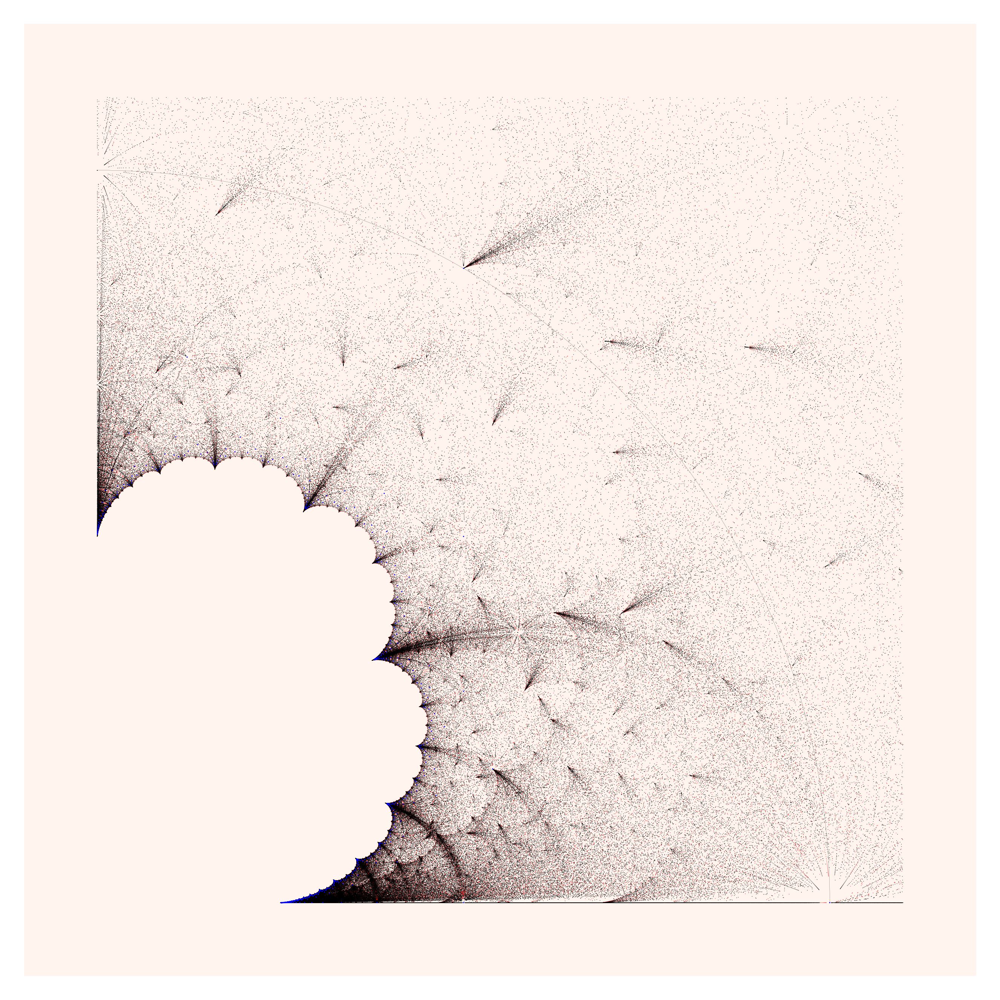

In [ ]:
show(arc((0,0), 1, sector=(0,pi/2), thickness=.2, color='black')
     +point2d(DL,size=1,color='red')
     +point2d(RL, size=1, color='black')
     +point2d(GL, size=5, color='blue')
     +polygon([[-.1,-.1],[-.1,1.2],[1.2,1.2],[1.2,-.1]],color='seashell', zorder=-1)
     ,
    aspect_ratio=1, figsize=40, axes=False)

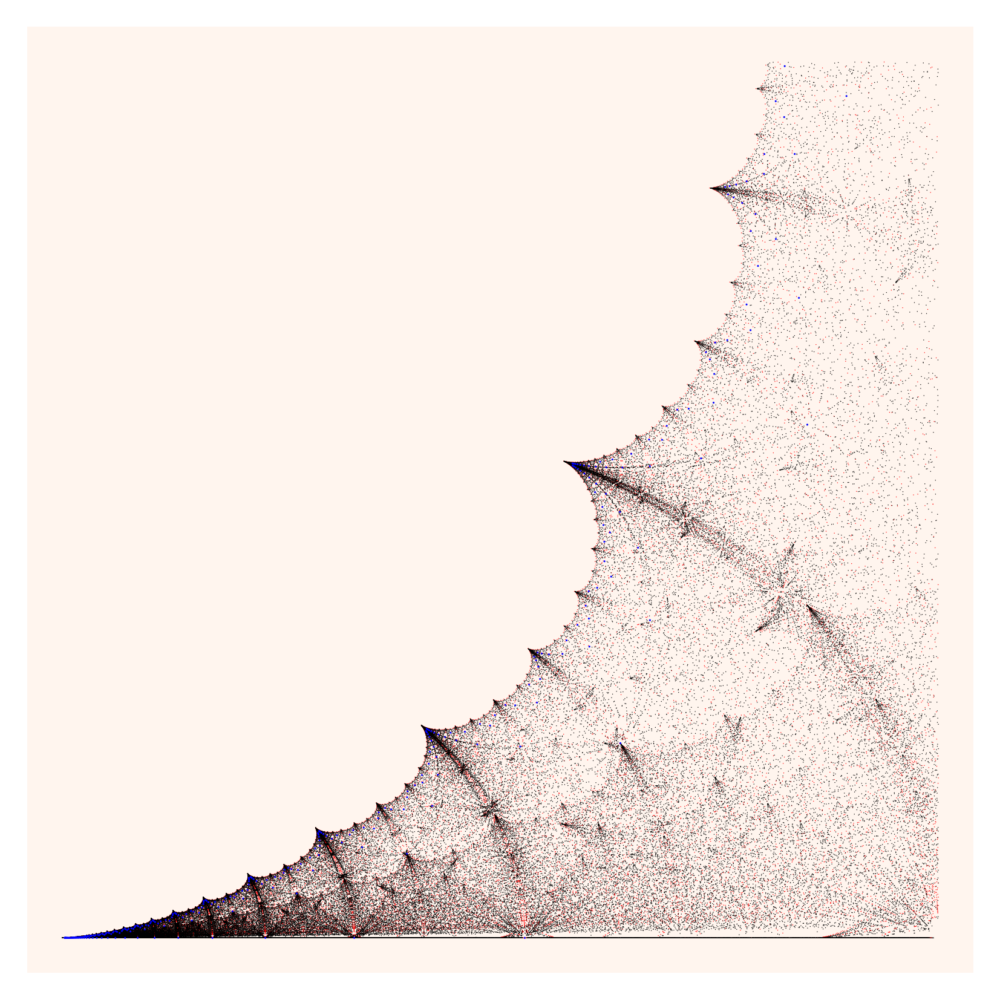

In [ ]:
show(point2d(sDL,size=1,color='red')
     +point2d(sRL, size=1, color='black')
     +point2d(sGL, size=5, color='blue')
     +polygon([[.24,-.01],[.24,.26],[.51,.26],[.51,-.01]],color='seashell', zorder=-1)
     ,
    aspect_ratio=1, figsize=25, axes=False)

In [ ]:
def cconj(pair): return [pair[0],-pair[1]]

def minus(pair): return [-pair[0],-pair[1]]

In [ ]:
bRL=sum([sum([list(filter(lambda rt: rt[0]<1.3 and rt[1]<2.1 and rt[0]>=-2.3,RD[D][N][1])) for N in RD[D].keys()],[]) for D in range(3,255)],[])
bDL=sum([sum([list(filter(lambda rt: rt[0]<1.3 and rt[1]<2.1 and rt[0]>=-2.3,DD[D][N][1])) for N in DD[D].keys()],[]) for D in range(3,128)],[])

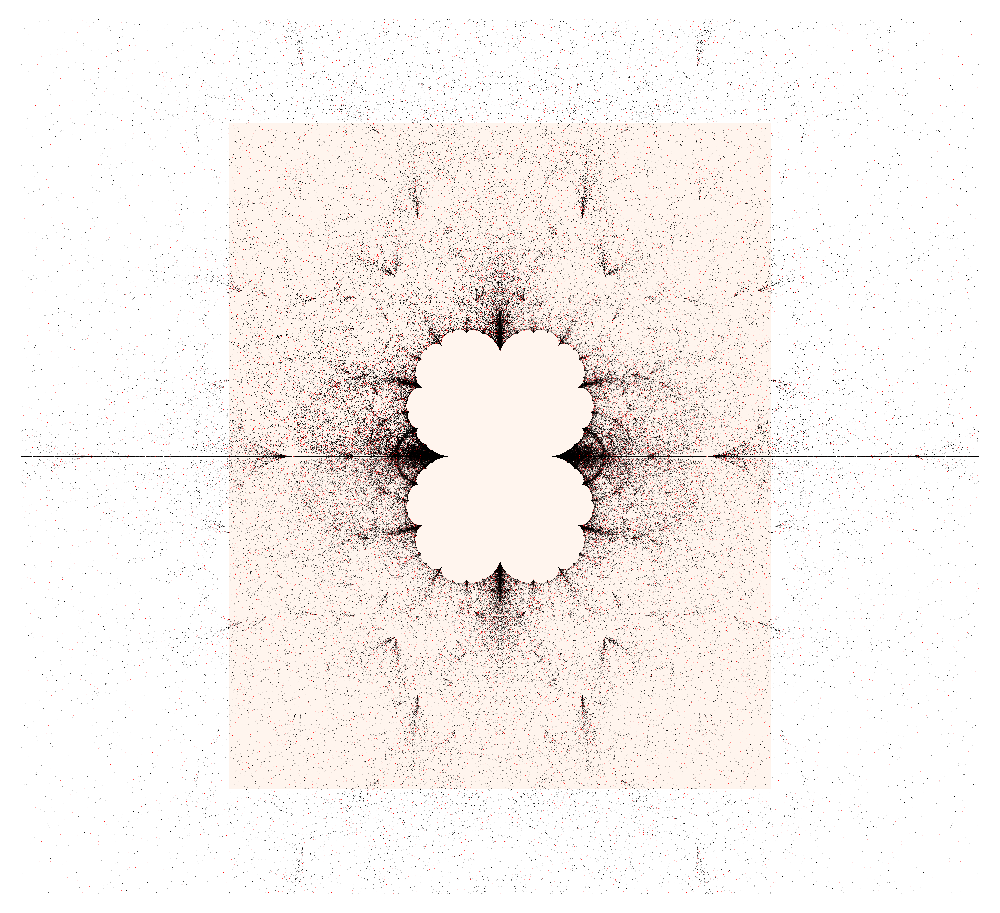

In [ ]:
show(arc((0,0), 1, sector=(0,pi), thickness=.2, color='black')
     +point2d(bDL,size=1,color='red')
     +point2d(list(map(cconj,bDL)), size=1, color='red')
     +point2d(list(map(minus,bDL)), size=1, color='red')
     +point2d(list(map(lambda p: cconj(minus(p)),bDL)), size=1, color='red')
     +point2d(list(map(lambda p: minus(cconj(p)),bDL)), size=1, color='red')
     +point2d(bRL, size=1, color='black')
     +point2d(list(map(cconj,bRL)), size=1, color='black')
     +point2d(list(map(minus,bRL)), size=1, color='black')
     +point2d(list(map(lambda p: cconj(minus(p)),bRL)), size=1, color='black')
     +point2d(list(map(lambda p: minus(cconj(p)),bRL)), size=1, color='black')
     +polygon([[-1.3,-1.6],[-1.3,1.6],[1.3,1.6],[1.3,-1.6]],color='seashell', zorder=-1)

     ,
    aspect_ratio=1, figsize=100, axes=False)

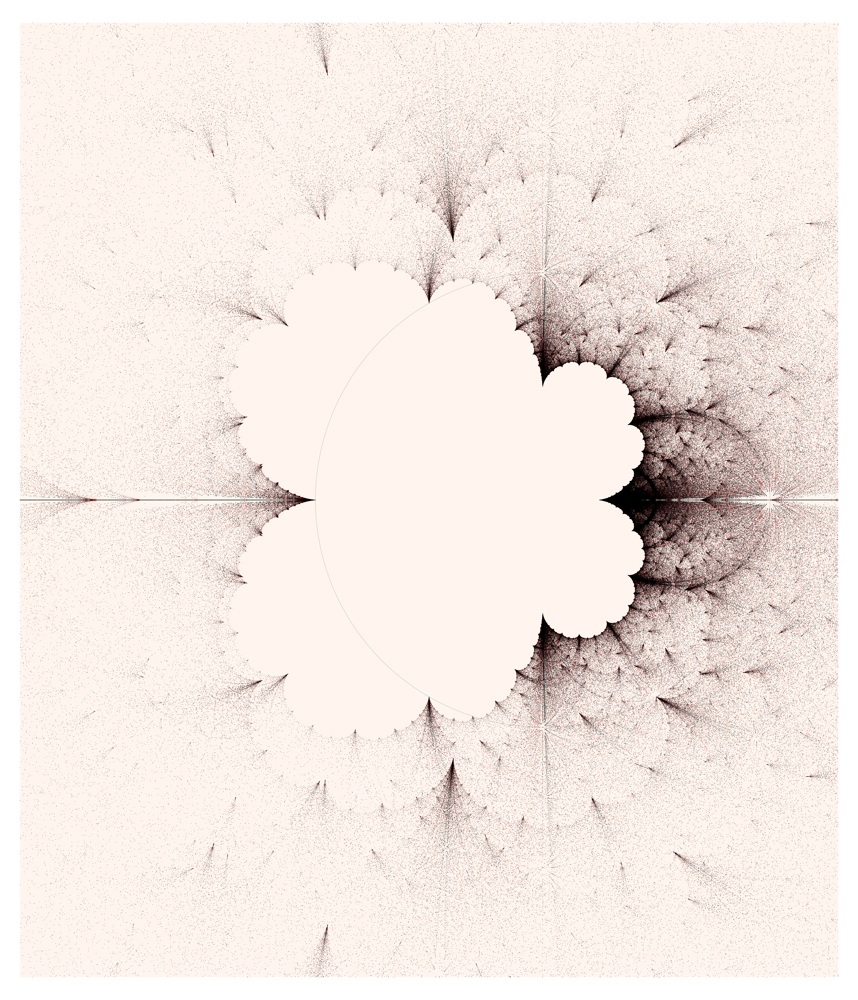

In [ ]:
show(arc((0,0), 1, sector=(0,2*pi), thickness=.2, color='black')
     +point2d(bDL,size=1,color='red')
     +point2d(list(map(cconj,bDL)), size=1, color='red')
     +point2d(bRL, size=1, color='black')
     +point2d(list(map(cconj,bRL)), size=1, color='black')
     +polygon([[-2.3,-2.1],[-2.3,2.1],[1.3,2.1],[1.3,-2.1]],color='seashell', zorder=-1)
     ,
    aspect_ratio=1, figsize=50, axes=False)

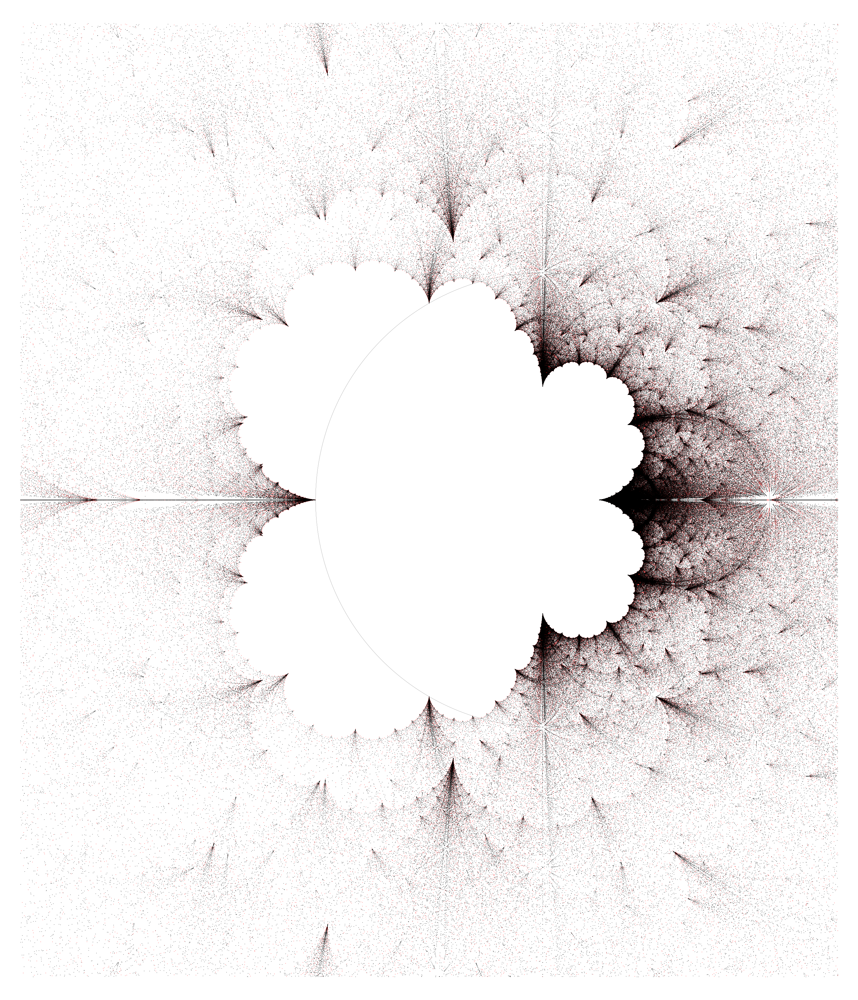

In [ ]:
show(arc((0,0), 1, sector=(0,2*pi), thickness=.2, color='black')
     +point2d(bDL,size=1,color='red')
     +point2d(list(map(cconj,bDL)), size=1, color='red')
     +point2d(bRL, size=1, color='black')
     +point2d(list(map(cconj,bRL)), size=1, color='black')
     #+polygon([[-2.3,-2.1],[-2.3,2.1],[1.3,2.1],[1.3,-2.1]],color='seashell', zorder=-1)
     ,
    aspect_ratio=1, figsize=50, axes=False)

In [ ]:
for N in RD[253].keys():
    if RD[255][N][1]==-1: 
        print (N)
        break

1


In [ ]:
save(RD, 'Q roots')

In [ ]:
save(DD, 'D roots')

In [ ]:
print(sum([len(list(BD[D].keys())) for D in range(3,254)])+sum([len(list(BD[D].keys())) for D in range(3,128)]))

12260


In [ ]:
len(RL), len(DL), len(bRL)+len(bDL)

(265931, 64565, 436076)

In [ ]:
len(sum([sum([RD[D][N][1] for N in RD[D].keys()],[]) for D in range(3,255)],[]))

447618

In [ ]:
mproot_select(PZ([12,31]))

[mpf('0.3512838774105686'), mpf('0.53953011710205356')]

In [ ]:
GRD=dict([(D, dict([(r.p,[vector([r.p,r.q]),-1]) for r in fractionline(D)]) ) for D in range(3,300)])

In [ ]:
def rootselect_batch(m,n):
    for D in range(m,n):
        #print(D)
        for N in GRD[D].keys():
            #print(N,D)
            if N==1: GRD[D][N][1]=[mp.mpf((1/4)*sec(pi/D)^2),mp.mpf(0)]
            else: 
                #print(mproot_select(PZ([N,D])))
                GRD[D][N][1]=mproot_select(PZ([N,D]))
    return 'done'

In [ ]:
%time rootselect_batch(3,50)

CPU times: user 11.9 s, sys: 141 ms, total: 12 s
Wall time: 12 s


'done'

In [ ]:
%time rootselect_batch(50,65)

CPU times: user 24.4 s, sys: 78 ms, total: 24.5 s
Wall time: 24.6 s


'done'

In [ ]:
def rootselect_batch(m,n):  # adjusted to only consider N/D which are larger than 1/6
    for D in range(m,n):
        #print(D)
        for N in GRD[D].keys():
            #print(N,D)
            if N/D>1/6: 
                GRD[D][N][1]=mproot_select(PZ([N,D]))
            #if N==1: GRD[D][N][1]=[mp.mpf((1/4)*sec(pi/D)^2),mp.mpf(0)]
            #else: 
            #    #print(mproot_select(PZ([N,D])))            
    return 'done'

In [ ]:
%time rootselect_batch(65, 70)

CPU times: user 5.8 s, sys: 15 ms, total: 5.81 s
Wall time: 5.98 s


'done'

In [ ]:
%time rootselect_batch(70,80)

CPU times: user 18.5 s, sys: 94 ms, total: 18.6 s
Wall time: 18.6 s


'done'

In [ ]:
%time rootselect_batch(80,85)

CPU times: user 7.36 s, sys: 0 ns, total: 7.36 s
Wall time: 7.39 s


'done'

In [ ]:
def rootselect_batch(m,n):  # adjusted to only consider N/D between 1/3 and 2/5
    for D in range(m,n):
        #print(D)
        for N in GRD[D].keys():
            #print(N,D)
            if N/D>1/3 and N/D<2/5: 
                GRD[D][N][1]=mproot_select(PZ([N,D]))
            #if N==1: GRD[D][N][1]=[mp.mpf((1/4)*sec(pi/D)^2),mp.mpf(0)]
            #else: 
            #    #print(mproot_select(PZ([N,D])))            
    return 'done'

In [ ]:
%time rootselect_batch(110,130)

CPU times: user 18.6 s, sys: 31 ms, total: 18.7 s
Wall time: 18.7 s


'done'

In [ ]:
def corner(c): # Left and right corners of Triangle(c)
    p, q, left, right, s = c[0], c[1], x, x, 1
    while left==x or right==x: 
        if left==x and  ((p*s-1)%q)==0:  left=vector([(p*s-1)/q,s])
        if right==x and ((p*s+1)%q)==0:  right=vector([(p*s+1)/q,s])
        s+=1
    return [left, right]

def lowcorner(c):
    pair=corner(c)
    if pair[0][1]<pair[1][1]: return pair[1]
    else: return pair[0]

In [ ]:
def numerators(den):
    return [num for num in GRD[den].keys() if GRD[den][num][1]!=-1]

In [ ]:
GRD[126][43][1]=-1

In [ ]:
denom=126

for p in numerators(denom):
    print (GRD[denom][p])

[(43, 126), None]
[(47, 126), [mpf('0.38121066127272929'), mpf('0.46396325955173634')]]


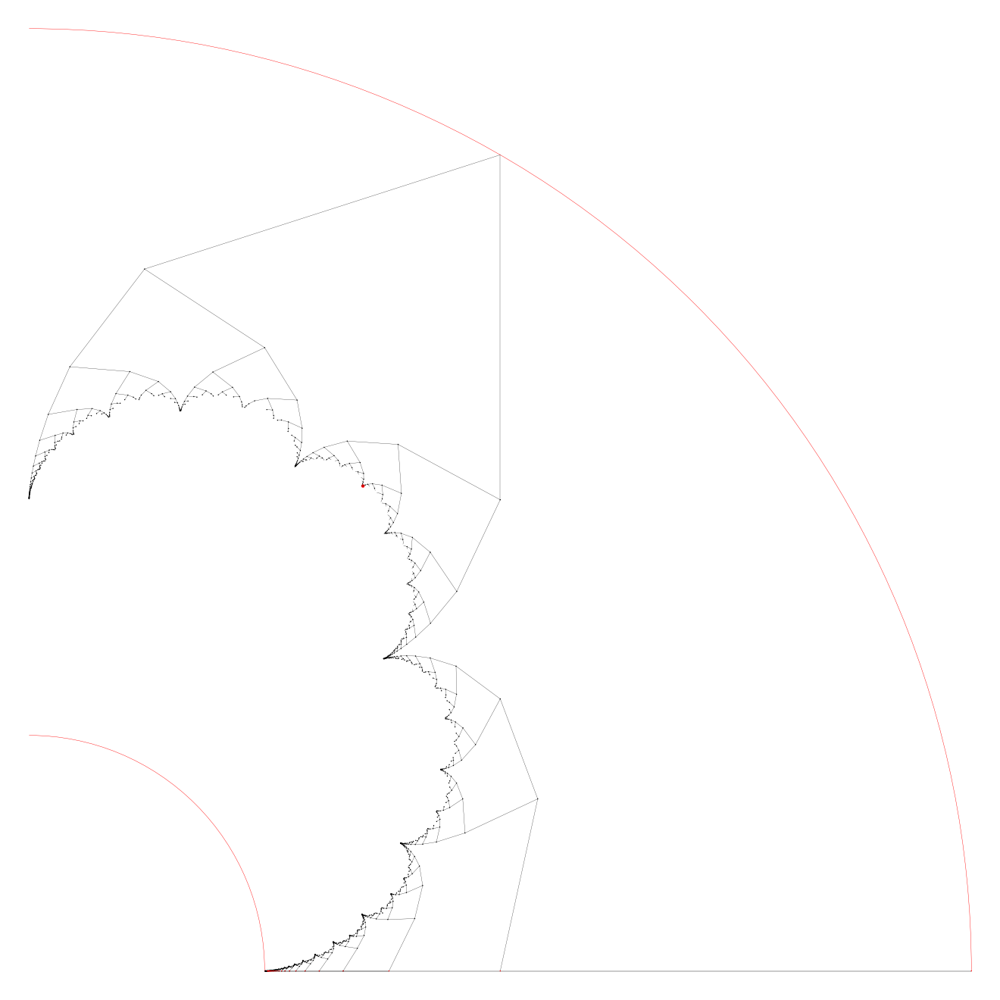

In [ ]:
show(
    sum([sum([line(map(lambda verts: GRD[verts[1]][verts[0]][1], [pair,lowcorner(pair)]), thickness=.2, color='black') for pair in [[p,q] for p in numerators(q)]]) for q in range(6,128)])+
    sum([point(map(lambda verts: GRD[verts[1]][verts[0]][1], [[p,q] for p in numerators(q)]), size=1, color='black') for q in range(6,88)])+
    #sum([point(list(map(lambda pair: GRD[pair[1]][pair[0]], [[p,q] for p in numerators(q)] )), size=1, zorder=10^50) for q in range(6,50)])+
     point(map(coor, [(1/4)*sec(pi/n)^2 for n in range(3,30)]), size=1, color='red', zorder=10)+
     line([[1,0],[1/4,0]], thickness=.3, color='black')+
    #line([[1,0],coor(rt([2,5]))], thickness=.3, color='orange')+
     arc((0,0), 1, sector=(0,pi/2),thickness=.3, color='red')+
     arc((0,0), 1/4, sector=(0,pi/2),thickness=.3, color='red')+
    point([.35433,.5146], color='red')
     , aspect_ratio=1, figsize=20, axes=False)

In [ ]:
Q([1,3])

-x + 1

In [ ]:
N(29/70)

TypeError: 'sage.rings.integer.Integer' object is not callable